In [1]:
import os
import sys
import random
import time
from random import seed, randint
import argparse
import platform
from datetime import datetime
import imp
import numpy as np
import fileinput
from itertools import product
import pandas as pd
from scipy.interpolate import griddata
from scipy.interpolate import interp2d
import seaborn as sns
from os import listdir

import matplotlib.pyplot as plt
import seaborn as sns
from scipy.interpolate import griddata
import matplotlib as mpl
sys.path.insert(0,'/Users/weilu/Research/opt_server/')
# from notebookFunctions import *
# from .. import notebookFunctions

from Bio.PDB.PDBParser import PDBParser
from pyCodeLib import *
%matplotlib inline
# plt.rcParams['figure.figsize'] = (10,6.180)    #golden ratio
# %matplotlib notebook
%load_ext autoreload
%autoreload 2

In [2]:
from Bio.PDB.Polypeptide import d1_to_index
from Bio.PDB.Polypeptide import dindex_to_1
from Bio.PDB.Polypeptide import aa3

In [3]:
plt.rcParams['figure.figsize'] = [16.18033, 10]    #golden ratio
plt.rcParams['figure.facecolor'] = 'w'
plt.rcParams['figure.dpi'] = 100

In [4]:
import plotly.express as px

In [5]:
import pickle
gmm_dic = {}
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
for res_type in res_type_list[1:]:
    gmm_dic[res_type] = pickle.load(open(f"/Users/weilu/opt/parameters/side_chain/gmm_{res_type}.pkl", mode='rb'))

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/utils/deprecation.py:144: FutureWarning:

The sklearn.mixture.gaussian_mixture module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.mixture. Anything that cannot be imported from sklearn.mixture is now part of the private API.

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/base.py:318: UserWarning:

Trying to unpickle estimator GaussianMixture from version 0.20.2 when using version 0.22.2.post1. This might lead to breaking code or invalid results. Use at your own risk.



In [6]:
parser = PDBParser()
# pre = "/Users/weilu/Research/server/may_week1_2020/evaluation_simulation/run1/1r69/T_300/"
pre = "/Users/weilu/Research/server/may_week1_2020/evaluation_simulation/setups/1r69/"
pdbFile = f"{pre}/cbd-openmmawsem.pdb"
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data_crystal_native = get_predicted_side_chain_state(structure[0], seq, gmm_dic)

normal?  <Residue NGP het=  resseq=1 icode= >
normal?  <Residue NGP het=  resseq=63 icode= >


In [8]:
parser = PDBParser()

# pre = "/Users/weilu/Research/server/may_week1_2020/evaluation_simulation/setups/1r69/"
# pdbFile = f"{pre}/cbd-openmmawsem.pdb"
pre = "/Users/weilu/Research/server/may_week1_2020/evaluation_simulation/run1/1r69/T_300/"
pdbFile = f"{pre}/movie.pdb"
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data = get_predicted_side_chain_state(structure[0], seq, gmm_dic)

normal?  <Residue NGP het=H_NGP resseq=1 icode= >
normal?  <Residue NGP het=H_NGP resseq=63 icode= >


In [11]:
len(models)

2500

In [45]:
data_submodes = []
for submode in [2, 3, 4, 5, 1]:
    pre = f"/Users/weilu/Research/server/may_week1_2020/evaluation_simulation/run1/1r69/T_300_subMode{submode}/"
    pdbFile = f"{pre}/movie.pdb"
    structure = parser.get_structure("X", pdbFile)
    models = list(structure.get_models())
    all_data = []
    for model in models:
        data_ = get_predicted_side_chain_state(model, seq, gmm_dic, verbose=False)
        all_data.append(data_)
    data = pd.concat(all_data).reset_index(drop=True).assign(subMode=submode)
    data_submodes.append(data)

In [46]:
data = pd.concat(data_submodes).reset_index(drop=True)

In [16]:
data = pd.concat(all_data).reset_index(drop=True)

In [19]:
data_res = data.query("index==6")

In [27]:
data.dtypes

index        int64
ResName     object
inState      int64
state1     float64
state2     float64
state3     float64
r1         float64
r2         float64
r3         float64
subMode      int64
dtype: object

In [97]:
convert = {1:"k_0.1", 2:"k_0.2", 3:"k_0.4", 4:"k_0.8", 5:"k_0.05"}
data["k"] = data["subMode"].apply(lambda x: convert[x])

In [60]:
data_database = pd.read_csv("/Users/weilu/Research/data/survey_represent_x_com_complete.csv", index_col=0)
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
# import plotly.express as px

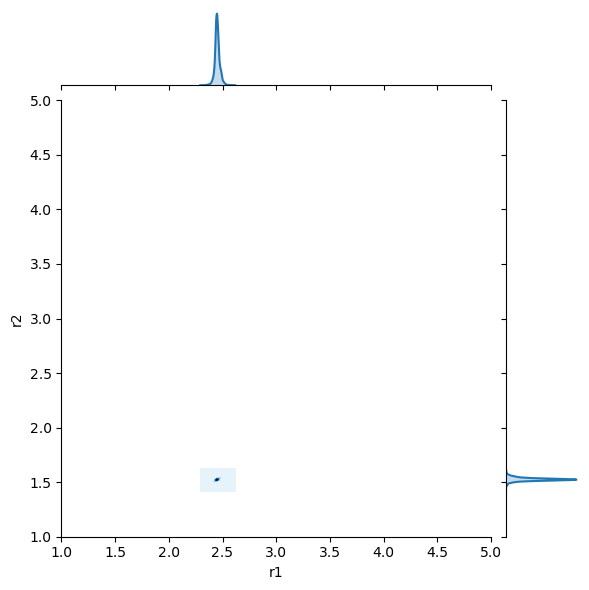

In [118]:
sampled = pd.DataFrame(gmm_dic["ALA"].sample(5000)[0], columns=["r1", "r2", "r3"])
# fig = px.scatter_3d(sampled, x='r1', y='r2', z='r3', opacity=0.01)
# fig.show()
sns.jointplot("r1", "r2", kind="kde", data=sampled, xlim=[1, 5],  ylim=[1, 5])

In [120]:
gmm = gmm_dic["ALA"]

In [121]:
gmm.means_

array([[2.45101564, 1.52694233, 2.50504454],
       [2.45642733, 1.52668103, 2.5100768 ],
       [2.44721018, 1.52264778, 2.50181717]])

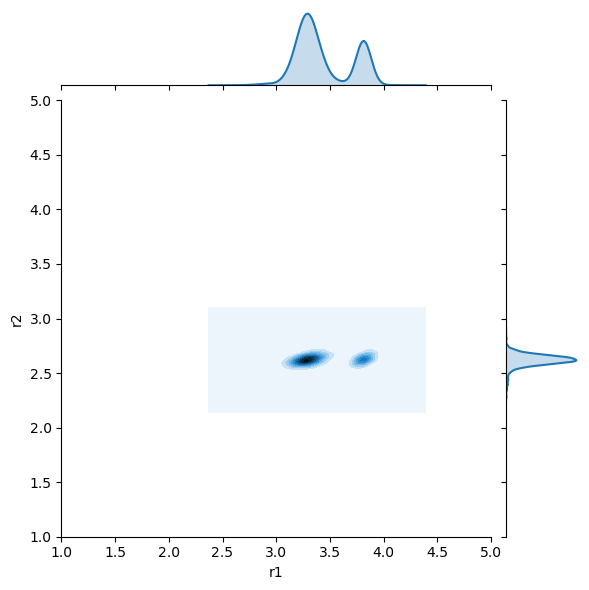

In [119]:
res = "LEU"
sampled = pd.DataFrame(gmm_dic[res].sample(5000)[0], columns=["r1", "r2", "r3"])
# fig = px.scatter_3d(sampled, x='r1', y='r2', z='r3', opacity=0.01)
# fig.show()
sns.jointplot("r1", "r2", kind="kde", data=sampled, xlim=[1, 5],  ylim=[1, 5])

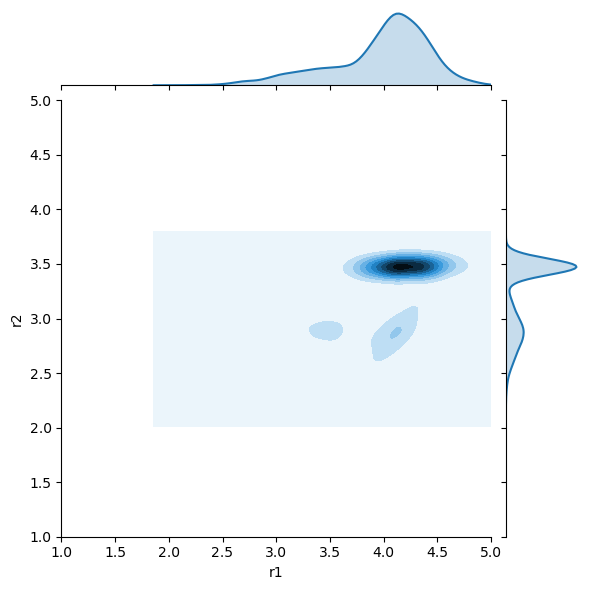

In [70]:
sampled = pd.DataFrame(gmm_dic[res].sample(5000)[0], columns=["r1", "r2", "r3"])
# fig = px.scatter_3d(sampled, x='r1', y='r2', z='r3', opacity=0.01)
# fig.show()
sns.jointplot("r1", "r2", kind="kde", data=sampled, xlim=[1, 5],  ylim=[1, 5])

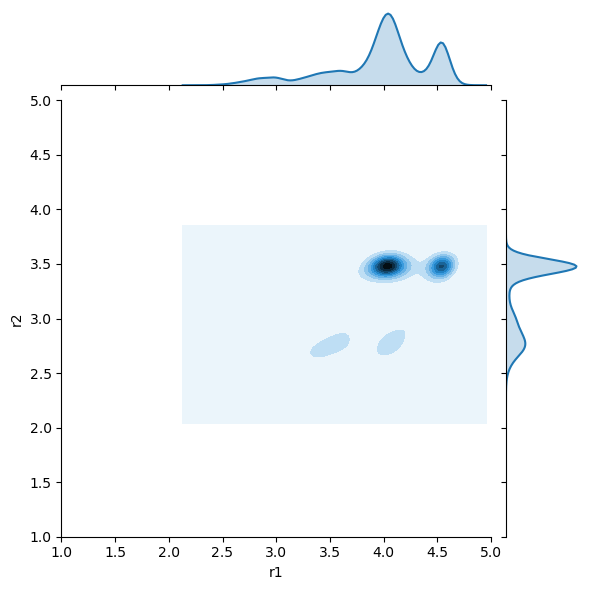

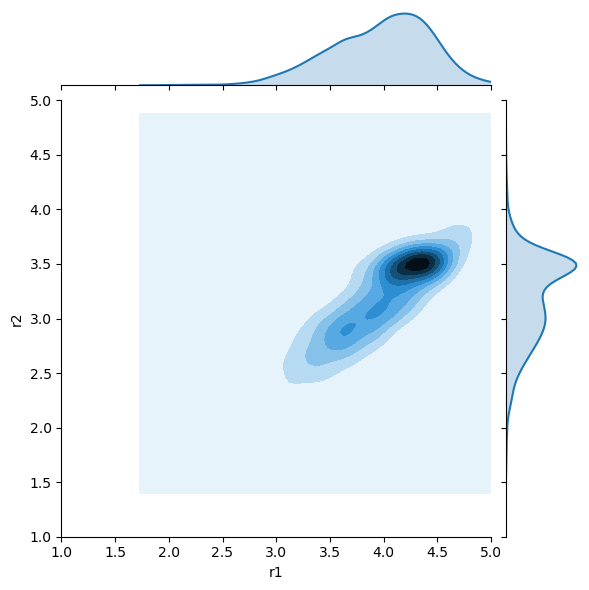

In [68]:
# data_res = data.query(f"index==32 and k=='k_0.1'")
res = "GLU"
data_res = data_database.query(f"ResName == '{res}'")
sns.jointplot("r1", "r2", kind="kde", data=data_res, xlim=[1, 5],  ylim=[1, 5])
data_res = data.query(f"index==32 and k=='k_0.1'")
sns.jointplot("r1", "r2", kind="kde", data=data_res, xlim=[1, 5],  ylim=[1, 5])


In [100]:
d["k"].unique()

array(['database', 'sampled', 'k_0.2', 'k_0.4', 'k_0.8', 'k_0.05',
       'k_0.1'], dtype=object)

In [103]:
res = "GLU"
selected_database = data_database.query(f"ResName == '{res}'").assign(k="database")
n = len(selected_database)
sampled = pd.DataFrame(gmm_dic[res].sample(n)[0], columns=["r1", "r2", "r3"]).assign(k="sampled")
selected_simulation = data.query(f"index==32")
d = pd.concat([selected_database, sampled, selected_simulation], sort=False)
d['k'] = pd.Categorical(d['k'], ["database", "sampled", "k_0.05", "k_0.1", "k_0.2", "k_0.4", "k_0.8"])

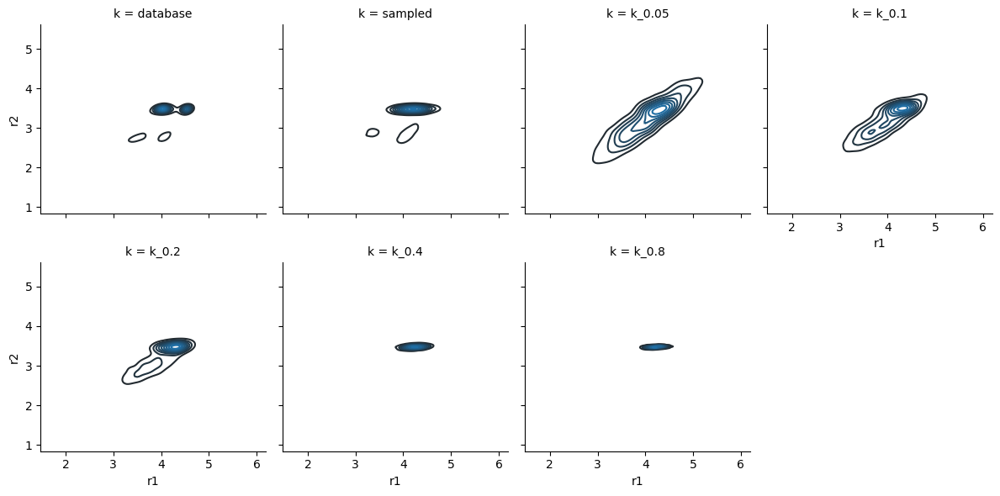

In [108]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r2")

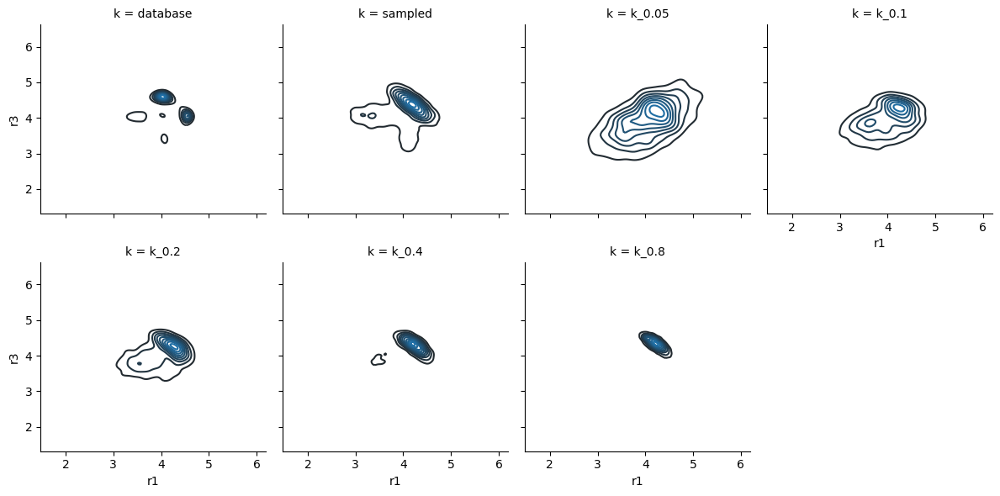

In [109]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r3")

In [110]:
res = "LEU"
selected_database = data_database.query(f"ResName == '{res}'").assign(k="database")
n = len(selected_database)
sampled = pd.DataFrame(gmm_dic[res].sample(n)[0], columns=["r1", "r2", "r3"]).assign(k="sampled")
selected_simulation = data.query(f"index==15")
d = pd.concat([selected_database, sampled, selected_simulation], sort=False)
d['k'] = pd.Categorical(d['k'], ["database", "sampled", "k_0.05", "k_0.1", "k_0.2", "k_0.4", "k_0.8"])

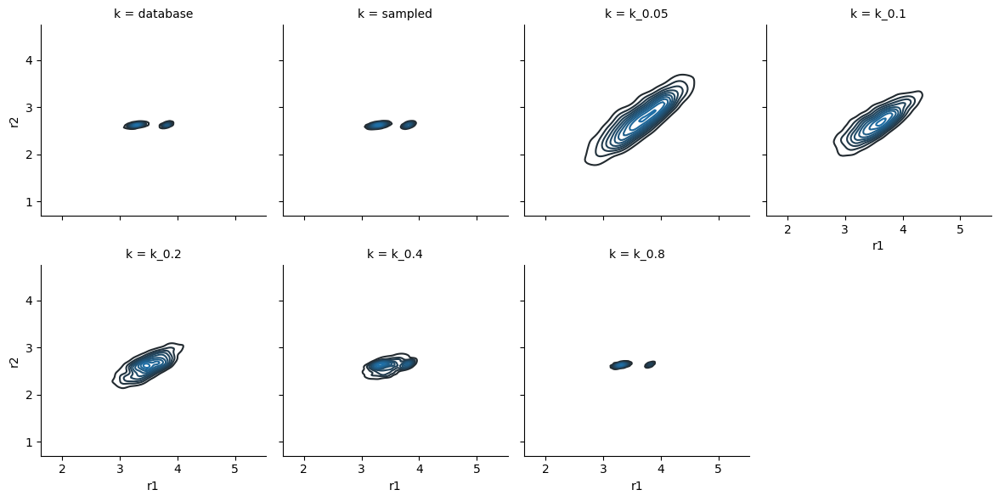

In [111]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r2")

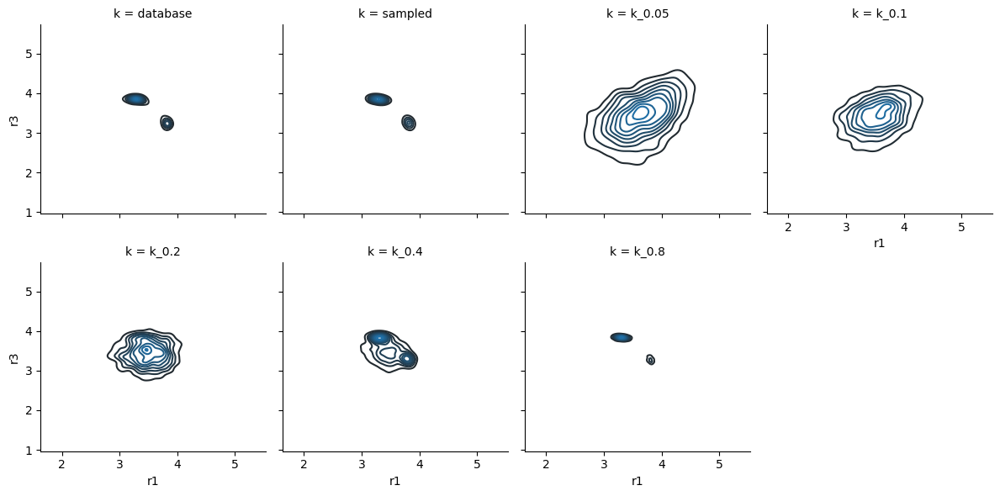

In [112]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r3")

In [113]:
res = "LEU"
index = 48 # leu buried inside.
selected_database = data_database.query(f"ResName == '{res}'").assign(k="database")
n = len(selected_database)
sampled = pd.DataFrame(gmm_dic[res].sample(n)[0], columns=["r1", "r2", "r3"]).assign(k="sampled")
selected_simulation = data.query(f"index=={index}")
d = pd.concat([selected_database, sampled, selected_simulation], sort=False)
d['k'] = pd.Categorical(d['k'], ["database", "sampled", "k_0.05", "k_0.1", "k_0.2", "k_0.4", "k_0.8"])

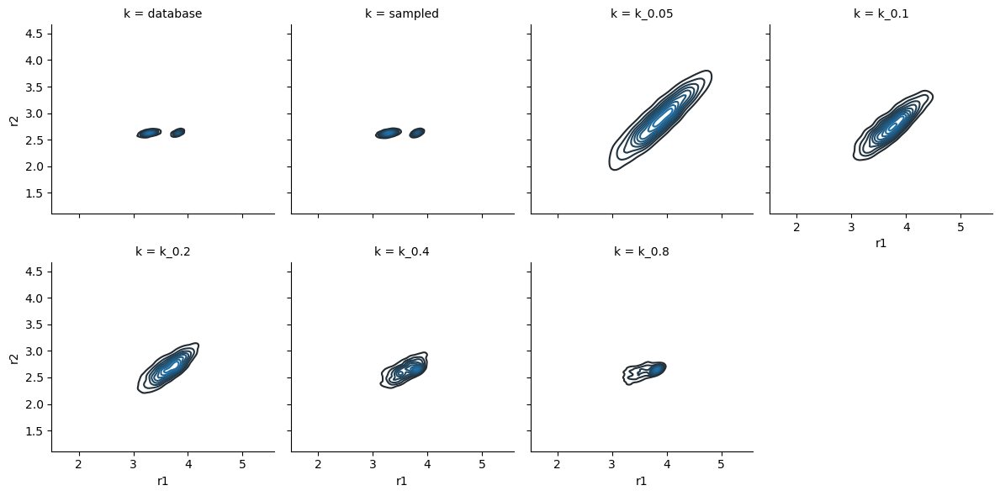

In [114]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r2")

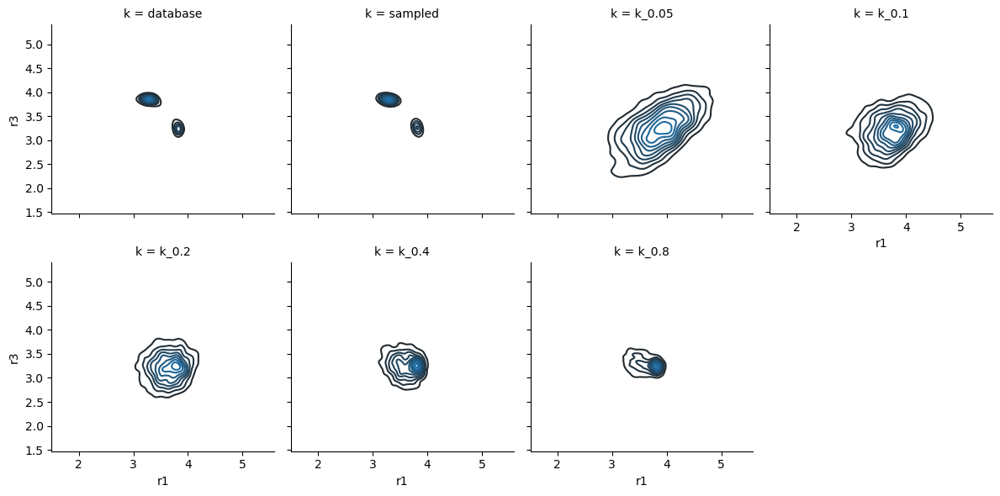

In [115]:
g = sns.FacetGrid(d, col="k", col_wrap=4)
g.map(sns.kdeplot, "r1", "r3")

In [37]:
res = "VAL"
data_res = data.query(f"index==6 and k!='k_0.1'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1, color="k")
fig.show()

VAL (10000, 11)


In [48]:
res = "VAL"
data_res = data.query(f"index==6")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1, color="k")
fig.show()

VAL (12500, 11)


In [22]:
res = "VAL"
data_res = data.query(f"index==6")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

VAL (2500, 9)


In [21]:
res = "VAL"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

VAL (10000, 9)


In [7]:
data_crystal_native

,index,ResName,inState,state1,state2,state3,r1,r2,r3
0,2,ILE,2,0.000,0.000,1.000,3.441787,2.366505,3.025309
1,3,SER,1,0.000,1.000,0.000,2.659765,1.952902,2.698823
2,4,SER,1,0.000,1.000,0.000,2.877835,1.968057,2.684202
3,5,ARG,1,0.000,0.961,0.039,4.592211,4.277790,5.471140
4,6,VAL,0,1.000,0.000,0.000,3.030110,1.968518,2.954797
5,7,LYS,2,0.000,0.000,1.000,4.486133,3.456408,4.413000
6,8,SER,2,0.000,0.000,1.000,3.148546,1.942220,2.570155
7,9,LYS,2,0.000,0.000,1.000,4.040492,3.159090,4.274173
8,10,ARG,2,0.000,0.000,1.000,4.972829,4.173192,4.395307
9,11,ILE,0,0.898,0.102,0.000,3.246857,2.412567,3.582233


In [ ]:
all_data = []
for model in models:
    data_ = get_predicted_side_chain_state(model, seq, gmm_dic, verbose=False)
    all_data.append(data_)

In [20]:
a = pd.read_csv("/Users/weilu/Research/server/mar_2020/side_chain_states/1bgf_iteration_0_stronger_exclude_volume.csv", index_col=0)

In [5]:
data = pd.read_csv("/Users/weilu/Research/server/mar_2020/side_chain_states/survey_represent_x_com_complete.csv", index_col=0)
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']

In [30]:
import pickle
gmm_dic = {}
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
for res_type in res_type_list[1:]:
    gmm_dic[res_type] = pickle.load(open(f"/Users/weilu/opt/parameters/side_chain/gmm_{res_type}.pkl", mode='rb'))

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/utils/deprecation.py:144: FutureWarning:

The sklearn.mixture.gaussian_mixture module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.mixture. Anything that cannot be imported from sklearn.mixture is now part of the private API.

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/base.py:318: UserWarning:

Trying to unpickle estimator GaussianMixture from version 0.20.2 when using version 0.22.2.post1. This might lead to breaking code or invalid results. Use at your own risk.



In [45]:
parser = PDBParser()
pre = "/Users/weilu/Research/server/mar_2020/mass_iterative_run/setups/1bgf/"
pdbFile = f"{pre}/cbd-openmmawsem.pdb"
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data_crystal_native = get_predicted_side_chain_state(structure[0], seq, gmm_dic)

normal?  <Residue NGP het=  resseq=124 icode= >


In [40]:
gmm_dic["VAL"].score(np.array([2.48, 1.58, 2.56]).reshape(1, -1))

-146.2169200828179

In [41]:
gmm_dic["VAL"].score(np.array([2.48, 1.9, 2.56]).reshape(1, -1))

-21.118761132768807

In [46]:
data_crystal_native.query("ResName == 'VAL'")

,index,ResName,inState,state1,state2,state3,r1,r2,r3
5,8,VAL,0,1.000,0.0,0.000,3.014360,1.978358,2.976245
16,19,VAL,1,0.000,1.0,0.000,2.705932,1.977582,2.977120
43,46,VAL,0,0.999,0.0,0.001,3.040289,1.962482,3.008203
68,72,VAL,1,0.000,1.0,0.000,2.758796,1.965252,3.045721
86,90,VAL,0,1.000,0.0,0.000,3.021011,1.967020,2.944839
96,102,VAL,0,1.000,0.0,0.000,3.042074,1.998857,3.022265
98,104,VAL,0,1.000,0.0,0.000,3.013701,1.957946,2.926710
99,105,VAL,0,1.000,0.0,0.000,3.018031,1.986069,2.988057


In [44]:
data_crystal_native.query("ResName == 'VAL'")

,index,ResName,inState,state1,state2,state3,r1,r2,r3
5,8,VAL,0,1.0,0.0,0.0,2.960908,1.978358,2.982052
16,19,VAL,1,0.0,1.0,0.0,2.632479,1.977582,2.991160
43,46,VAL,0,1.0,0.0,0.0,2.959563,1.962482,2.991221
68,72,VAL,1,0.0,1.0,0.0,2.667226,1.965252,3.037100
86,90,VAL,0,1.0,0.0,0.0,2.969390,1.967020,2.941497
96,102,VAL,0,1.0,0.0,0.0,2.970641,1.998857,3.023028
98,104,VAL,0,1.0,0.0,0.0,2.978603,1.957946,2.919249
99,105,VAL,0,1.0,0.0,0.0,2.950815,1.986069,2.980733


In [22]:
a.head()

,index,ResName,inState,state1,state2,state3,r1,r2,r3,Frame
0,3,SER,2,0.0,0.001,0.999,2.954489,1.791114,1.840801,0
1,4,GLN,1,0.0,1.000,0.000,4.657433,4.278511,4.681931,0
2,5,TRP,1,0.0,1.000,0.000,3.900978,3.505838,4.737189,0
3,6,ASN,1,0.0,1.000,0.000,3.729485,2.614009,3.206870,0
4,7,GLN,1,0.0,1.000,0.000,4.430459,3.330556,3.156073,0


In [9]:
b = a.head().reset_index(drop=True)

In [11]:
a= a.rename(columns={"cbd_n":"r1", "cbd_ca":"r2", "cbd_c":"r3", "ResType":"ResName"})

In [21]:
a.query(f"Frame==-1 and ResName == '{res}'")

,index,ResName,inState,state1,state2,state3,r1,r2,r3,Frame
5,8,VAL,0,0.940,0.0,0.060,2.511318,1.579789,2.560823,-1
16,19,VAL,0,0.946,0.0,0.054,2.511898,1.580330,2.561772,-1
43,46,VAL,0,0.949,0.0,0.051,2.511178,1.580303,2.561850,-1
68,72,VAL,0,0.949,0.0,0.051,2.511018,1.580196,2.561850,-1
86,90,VAL,0,0.955,0.0,0.045,2.510391,1.580407,2.562203,-1
96,102,VAL,0,0.923,0.0,0.077,2.513415,1.579269,2.561292,-1
98,104,VAL,0,0.932,0.0,0.068,2.513810,1.579974,2.562002,-1
99,105,VAL,0,0.970,0.0,0.030,2.504353,1.579850,2.561749,-1


In [18]:
a.query(f"Frame=='native' and ResName == '{res}'")

,index,ResName,inState,state1,state2,state3,r1,r2,r3,Frame
3,5,VAL,0,0.949,0.0,0.051,2.512987,1.580924,2.562628,native
25,30,VAL,0,0.951,0.0,0.049,2.511665,1.580843,2.561751,native
30,36,VAL,0,0.938,0.0,0.062,2.512718,1.579610,2.562734,native
53,61,VAL,0,0.959,0.0,0.041,2.510048,1.580761,2.562208,native
57,65,VAL,0,0.949,0.0,0.051,2.510731,1.580118,2.561754,native
70,80,VAL,0,0.967,0.0,0.033,2.507250,1.580433,2.562435,native
71,81,VAL,0,0.945,0.0,0.055,2.511791,1.579974,2.562289,native
78,88,VAL,0,0.967,0.0,0.033,2.507424,1.580653,2.562180,native
81,92,VAL,0,0.963,0.0,0.037,2.507728,1.580490,2.561576,native
87,98,VAL,0,0.958,0.0,0.042,2.510343,1.580796,2.562405,native


In [14]:
res = "VAL"
a.query(f"ResName == '{res}' and r2 < 1.59")

,index,ResName,inState,state1,state2,state3,r1,r2,r3,Frame
3,5,VAL,0,0.949,0.0,0.051,2.512987,1.580924,2.562628,native
25,30,VAL,0,0.951,0.0,0.049,2.511665,1.580843,2.561751,native
30,36,VAL,0,0.938,0.0,0.062,2.512718,1.579610,2.562734,native
53,61,VAL,0,0.959,0.0,0.041,2.510048,1.580761,2.562208,native
57,65,VAL,0,0.949,0.0,0.051,2.510731,1.580118,2.561754,native
70,80,VAL,0,0.967,0.0,0.033,2.507250,1.580433,2.562435,native
71,81,VAL,0,0.945,0.0,0.055,2.511791,1.579974,2.562289,native
78,88,VAL,0,0.967,0.0,0.033,2.507424,1.580653,2.562180,native
81,92,VAL,0,0.963,0.0,0.037,2.507728,1.580490,2.561576,native
87,98,VAL,0,0.958,0.0,0.042,2.510343,1.580796,2.562405,native


In [52]:
import plotly.express as px
res = "VAL"
a_data = a.query(f"ResName == '{res}' and (Frame > 1980)").reset_index(drop=True)
# print(res, data_res.shape)
fig = px.scatter_3d(a_data, x='r1', y='r2', z='r3', opacity=0.1, color="index")
fig.show()

In [54]:
a = np.random.randint(5, size=(4,2,1))

In [50]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "VAL"
data_res = data.query(f"ResName == '{res}'").reset_index(drop=True)
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
# gmm = gmm_dic[res]
# a = gmm.sample(10000)[0]
# a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data = a.query(f"ResName == '{res}' and (Frame > 1980)").reset_index(drop=True)
a_data = a_data[["r1", "r2", "r3"]]
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [23]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "VAL"
data_res = data.query(f"ResName == '{res}'").reset_index(drop=True)
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
# gmm = gmm_dic[res]
# a = gmm.sample(10000)[0]
# a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data = a.query(f"ResName == '{res}' and Frame != 1").reset_index(drop=True)
a_data = a_data[["r1", "r2", "r3"]]
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [15]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "VAL"
data_res = data.query(f"ResName == '{res}'").reset_index(drop=True)
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
# gmm = gmm_dic[res]
# a = gmm.sample(10000)[0]
# a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data = a.query(f"ResName == '{res}'").reset_index(drop=True)
a_data = a_data[["r1", "r2", "r3"]]
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [ ]:
import plotly.express as px
res = "VAL"
data_res = a.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1, color="Frame")
fig.show()

VAL (26013, 10)


In [6]:
import plotly.express as px
res = "VAL"
data_res = data.query(f"ResName == '{res}'")
print(res, data_res.shape)
fig = px.scatter_3d(data_res, x='r1', y='r2', z='r3', opacity=0.1)
fig.show()

VAL (5386, 7)


In [ ]:
# res_type_list = ['GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
res = "HIS"
data_res = data.query(f"ResName == '{res}'")
data_res = data_res[["r1", "r2", "r3"]]
data_res["source"] = "database"
gmm = gmm_dic[res]
a = gmm.sample(10000)[0]
a_data = pd.DataFrame(a, columns=["r1", "r2", "r3"])
a_data["source"] = "sampled"
combined = pd.concat([a_data, data_res])
fig = px.scatter_3d(combined, x='r1', y='r2', z='r3', color="source", opacity=0.1)
fig.show()

In [4]:
def dis(a, b):
    return ((a[0]-b[0])**2 + (a[1]-b[1])**2 + (a[2]-b[2])**2)**0.5

def compute_side_chain_energy_for_x(x, means, precisions_chol, log_det, weights):
    n_features = 3
    n_components, _ = means.shape

    mean_dot_precisions_chol = np.zeros((3,3))
    log_prob = np.zeros(3)
    for i in range(n_components):
        mean_dot_precisions_chol[i] = np.dot(means[i], precisions_chol[i])
        y = np.dot(x, precisions_chol[i]) - mean_dot_precisions_chol[i]
        log_prob[i] = np.sum(np.square(y))

    log_gaussian_prob = -.5 * (n_features * np.log(2 * np.pi) + log_prob) + log_det
    c = np.max(log_gaussian_prob + np.log(weights))
    score = np.log(np.sum(np.exp(log_gaussian_prob + np.log(weights) - c))) + c
    kt = 1
    E_side_chain = -score*kt
    # print(E_side_chain)
    return E_side_chain

def read_fasta(fastaFile):
    seq = ""
    with open(fastaFile, "r") as f:
        for line in f:
            if line[0] == ">":
                pass
            else:
                # print(line)
                seq += line.strip()
    return seq

def compute_side_chain_energy(structure, seq):
    E_side_chain_energy = 0
    # parser = PDBParser()
    # pdbFile = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/native/256_cbd_submode_7_debug/crystal_structure.pdb"
    # fastaFile = "/Users/weilu/Research/server/feb_2020/compare_side_chain_with_and_without/native/256_cbd_submode_7_debug/crystal_structure.fasta"
    # structure = parser.get_structure("x", pdbFile)
    print(seq)

    means_dic = {}
    precisions_chol_dic = {}
    log_det_dic = {}
    weights_dic = {}
    res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
    for res_type in res_type_list:
        if res_type == "GLY":
            continue

        means = np.loadtxt(f"/Users/weilu/opt/parameters/side_chain/{res_type}_means.txt")
        precisions_chol = np.loadtxt(f"/Users/weilu/opt/parameters/side_chain/{res_type}_precisions_chol.txt").reshape(3,3,3)
        log_det = np.loadtxt(f"/Users/weilu/opt/parameters/side_chain/{res_type}_log_det.txt")
        weights = np.loadtxt(f"/Users/weilu/opt/parameters/side_chain/{res_type}_weights.txt")
        means_dic[res_type] = means

        precisions_chol_dic[res_type] = precisions_chol
        log_det_dic[res_type] = log_det
        weights_dic[res_type] = weights

    for res in structure.get_residues():
        if res.get_full_id()[1] != 0:
            continue
        # x_com = get_side_chain_center_of_mass(res)
        # resname = res.resname
        resname = one_to_three(seq[res.id[1]-1])
        if resname == "GLY":
            continue
        try:
            n = res["N"].get_coord()
            ca = res["CA"].get_coord()
            c = res["C"].get_coord()
        except:
            continue
        x_com = res["CB"].get_coord()
        x = np.array([dis(x_com, n), dis(x_com, ca), dis(x_com, c)])
        r_ca_com = dis(x_com, ca)
    #     resname = "TYR"
        if resname == "GLY":
            side_chain_energy = 0
        else:
            side_chain_energy = compute_side_chain_energy_for_x(x, means_dic[resname],
                                                                precisions_chol_dic[resname],
                                                                log_det_dic[resname],
                                                                weights_dic[resname])
        if abs(side_chain_energy) > 10:
            print(res.id[1], resname, x_com, x, round(side_chain_energy,3), round(r_ca_com,3))
        # print(res.id[1], resname, x_com, round(side_chain_energy,3), round(r_ca_com,3))
        E_side_chain_energy += side_chain_energy
    return E_side_chain_energy


In [8]:
pre = "/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_1_stronger_exclude_withoutBurial_bugfix/1a32/0/"
pdbFile = f"{pre}/lastFrame.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")

In [9]:
compute_side_chain_energy(structure, seq)

LTQERKREIIEQFKVHENDTGSPEVQIAILTEQINNLNEHLRVHKKDHHSRRGLLKMVGKRRRLLAYLRNKDVARYREIVEKLGL
13 PHE [124.046  38.075 -41.114] [3.7025952  3.55207984 4.82528966] 10.318 3.552
27 ILE [126.89   35.432 -24.481] [4.02739389 3.05318558 3.69282072] 12.724 3.053
35 ASN [121.824  42.369 -31.988] [2.80029669 2.69713334 4.00617899] 14.025 2.697
44 HIS [117.957  44.064 -48.768] [3.96171941 3.18628443 2.63656836] 10.498 3.186


198.09652994806035

In [10]:
pre = "/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_0_stronger_exclude_volume/1a32/0"
pdbFile = f"{pre}/lastFrame.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
compute_side_chain_energy(structure, seq)

LTQERKREIIEQFKVHENDTGSPEVQIAILTEQINNLNEHLRVHKKDHHSRRGLLKMVGKRRRLLAYLRNKDVARYREIVEKLGL
10 ILE [104.989  47.426 -49.573] [3.11944254 2.23345362 2.76482566] 10.153 2.233
16 HIS [114.593  42.001 -50.234] [3.68462967 3.15663628 4.24888711] 22.761 3.157
30 LEU [130.475  43.418 -33.846] [4.24353063 3.18629259 3.3641718 ] 11.914 3.186
41 LEU [143.382  46.487 -39.677] [3.87228303 3.16353409 4.20423009] 12.814 3.164
45 LYS [151.937  46.171 -45.619] [4.21373287 4.64055871 5.50145576] 13.748 4.641
76 TYR [130.958  37.879 -22.967] [5.17101707 4.06451709 4.08804776] 17.144 4.065


159.84262209291515

In [6]:
import pickle

In [9]:
g = pickle.load(open("/Users/weilu/opt/parameters/side_chain/gmm_TYR.pkl", mode='rb'))

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator GaussianMixture from version 0.20.2 when using version 0.22.2.post1. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [15]:

a = g.predict_proba(np.array([5.17101707,4.06451709, 4.08804776]).reshape(1, -1))

In [18]:
a.round(3)

array([[0.03, 0.  , 0.97]])

In [14]:
g.score(np.array([5.17101707,4.06451709, 4.08804776]).reshape(1, -1))

-17.14370974177691

In [24]:
gmm_dic = {}
res_type_list = ['GLY', 'ALA', 'VAL', 'CYS', 'PRO', 'LEU', 'ILE', 'MET', 'TRP', 'PHE', 'SER', 'THR', 'TYR', 'GLN', 'ASN', 'LYS', 'ARG', 'HIS', 'ASP', 'GLU']
for res_type in res_type_list[1:]:
    gmm_dic[res_type] = pickle.load(open(f"/Users/weilu/opt/parameters/side_chain/gmm_{res_type}.pkl", mode='rb'))

/Users/weilu/anaconda/lib/python3.6/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator GaussianMixture from version 0.20.2 when using version 0.22.2.post1. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [101]:
def get_predicted_side_chain_state(model, seq, gmm_dic=gmm_dic, verbose=True):
    info_ = []
    for res in model.get_residues():
        # if res.get_full_id()[1] != 0:
        #     continue
        # x_com = get_side_chain_center_of_mass(res)
        # resname = res.resname
        resname = one_to_three(seq[res.id[1]-1])
        if resname == "GLY":
            continue
        try:
            n = res["N"].get_coord()
            ca = res["CA"].get_coord()
            c = res["C"].get_coord()
        except:
            if verbose:
                print("normal? ", res)
            continue
        x_com = res["CB"].get_coord()
        x = np.array([dis(x_com, n), dis(x_com, ca), dis(x_com, c)])
        r_ca_com = dis(x_com, ca)
    #     resname = "TYR"
        if resname == "GLY":
            prediction = [0, 0, 0]
        else:
            prediction = gmm_dic[resname].predict_proba(np.array(x).reshape(1, -1))[0].round(3)
        info_.append([res.id[1], resname, np.argmax(prediction), prediction[0], prediction[1], prediction[2]])
    data = pd.DataFrame(info_, columns=["index", "ResType", "inState", "state1", "state2", "state3"])
    return data

In [76]:
pdb = "1a32"
pre = f"/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_0_stronger_exclude_volume/{pdb}/0"
pdbFile = f"{pre}/movie.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
# data_lastFrame = get_predicted_side_chain_state(structure, seq)

In [86]:
data.to_csv("")

In [107]:
all_models = list(structure.get_models())
data_ = []
for i, model in enumerate(all_models):
    # print(model)
    data_oneFrame = get_predicted_side_chain_state(model, seq, verbose=False)
    data_.append(data_oneFrame.assign(Frame=i))

In [109]:
data = pd.concat(data_)

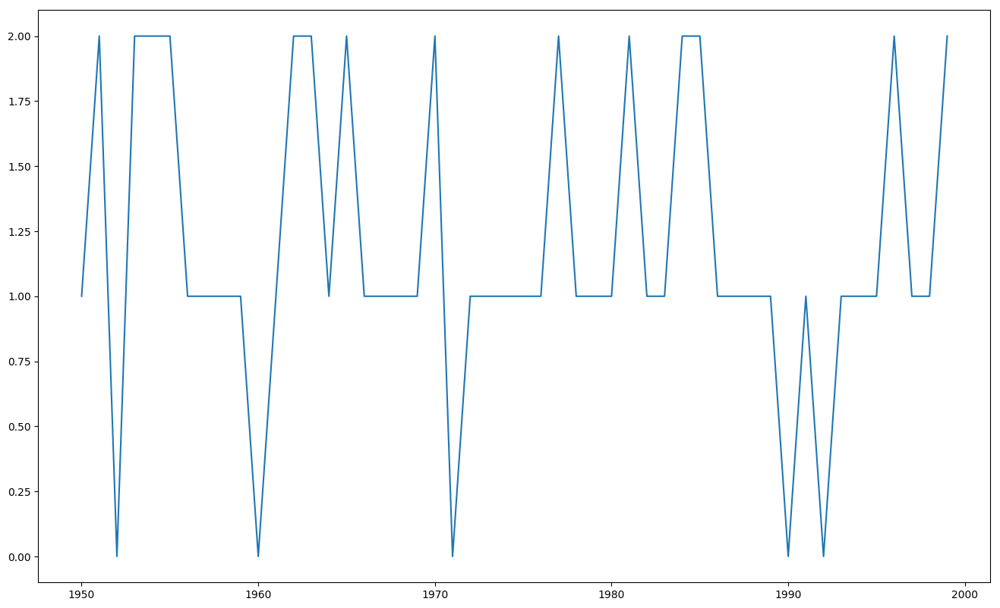

In [114]:
a = data.query("index == 2").reset_index(drop=True)
plt.plot(a["inState"][-50:])

In [147]:
data

,index,ResType,inState,state1,state2,state3,Frame
0,2,THR,1,0.000,1.0,0.000,0
1,3,GLN,1,0.000,1.0,0.000,0
2,4,GLU,2,0.115,0.0,0.885,0
3,5,ARG,2,0.000,0.0,1.000,0
4,6,LYS,2,0.000,0.0,1.000,0
...,...,...,...,...,...,...,...
74,79,ILE,2,0.000,0.0,1.000,1999
75,80,VAL,0,0.844,0.0,0.156,1999
76,81,GLU,2,0.000,0.0,1.000,1999
77,82,LYS,2,0.006,0.0,0.994,1999


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x131415400>]],
      dtype=object)

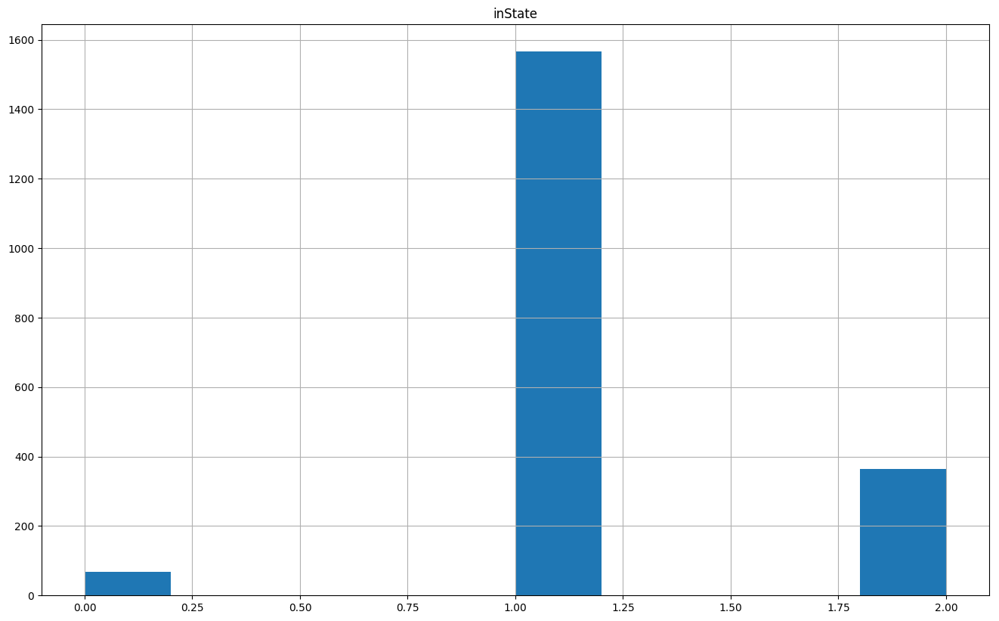

In [146]:
data.query("index == 3").hist("inState")

In [96]:
get_predicted_side_chain_state(all_models[1], seq)

,index,ResType,inState,state1,state2,state3


In [148]:
gmm = gmm_dic["GLN"]
gmm.weights_

array([0.35562821, 0.41894632, 0.22542547])

In [120]:
gmm = gmm_dic["THR"]
gmm.weights_

array([0.43363504, 0.08728756, 0.47907739])

In [149]:
data_openMM_native

,index,ResType,inState,state1,state2,state3
0,2,THR,0,1.000,0.000,0.000
1,3,GLN,0,0.964,0.000,0.036
2,4,GLU,0,1.000,0.000,0.000
3,5,ARG,0,0.602,0.000,0.398
4,6,LYS,1,0.000,0.934,0.066
...,...,...,...,...,...,...
74,79,ILE,2,0.000,0.000,1.000
75,80,VAL,0,1.000,0.000,0.000
76,81,GLU,1,0.001,0.999,0.000
77,82,LYS,0,0.994,0.000,0.006


In [136]:
a = data_openMM_native.merge(data_native, on="index")

In [138]:
# (data_native.values[1:-1, 2:] -  data_openMM_native.values[:, 2:]).astype(float).round(2)
a[a["inState_x"]!=a["inState_y"]]

,index,ResType_x,inState_x,state1_x,state2_x,state3_x,ResType_y,inState_y,state1_y,state2_y,state3_y
20,23,PRO,1,0.000,0.841,0.159,PRO,2,0.000,0.024,0.976
25,28,ALA,1,0.286,0.714,0.000,ALA,2,0.003,0.119,0.878
56,61,ARG,0,0.827,0.000,0.173,ARG,2,0.487,0.000,0.513
61,66,ALA,1,0.108,0.892,0.000,ALA,2,0.022,0.421,0.557
69,74,ALA,1,0.104,0.895,0.001,ALA,2,0.003,0.088,0.909


In [58]:
pdb = "1a32"
pre = f"/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_0_stronger_exclude_volume/{pdb}/0"
pdbFile = f"{pre}/lastFrame.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data_lastFrame = get_predicted_side_chain_state(structure, seq)

normal?  <Residue LEU het=  resseq=1 icode= >
normal?  <Residue LEU het=  resseq=85 icode= >


In [59]:
pre = f"/Users/weilu/Research/server/mar_2020/mass_iterative_run/setups/{pdb}"
pdbFile = f"{pre}/cbd.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data_native = get_predicted_side_chain_state(structure, seq)

In [126]:
pre = f"/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_native_new_4/{pdb}/0"
pdbFile = f"{pre}/native.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
data_openMM_native = get_predicted_side_chain_state(structure[0], seq)

normal?  <Residue NGP het=H_NGP resseq=1 icode= >
normal?  <Residue NGP het=H_NGP resseq=85 icode= >


In [63]:
data_combined = data_lastFrame.merge(data_native, on=["index"])

In [66]:
data_combined.columns

Index(['index', 'ResType_x', 'inState_x', 'state1_x', 'state2_x', 'state3_x',
       'ResType_y', 'inState_y', 'state1_y', 'state2_y', 'state3_y'],
      dtype='object')

In [68]:
np.sum(data_combined["inState_x"] == data_combined["inState_y"])

30

In [69]:
data_combined

,index,ResType_x,inState_x,state1_x,state2_x,state3_x,ResType_y,inState_y,state1_y,state2_y,state3_y
0,2,THR,2,0.000,0.000,1.000,THR,0,1.000,0.000,0.000
1,3,GLN,2,0.000,0.000,1.000,GLN,0,0.945,0.000,0.054
2,4,GLU,0,1.000,0.000,0.000,GLU,0,1.000,0.000,0.000
3,5,ARG,2,0.000,0.000,1.000,ARG,0,0.639,0.000,0.361
4,6,LYS,2,0.000,0.001,0.999,LYS,1,0.000,0.970,0.030
...,...,...,...,...,...,...,...,...,...,...,...
74,79,ILE,2,0.000,0.000,1.000,ILE,2,0.000,0.000,1.000
75,80,VAL,0,0.844,0.000,0.156,VAL,0,1.000,0.000,0.000
76,81,GLU,2,0.000,0.000,1.000,GLU,1,0.001,0.999,0.000
77,82,LYS,2,0.006,0.000,0.994,LYS,0,0.993,0.000,0.007


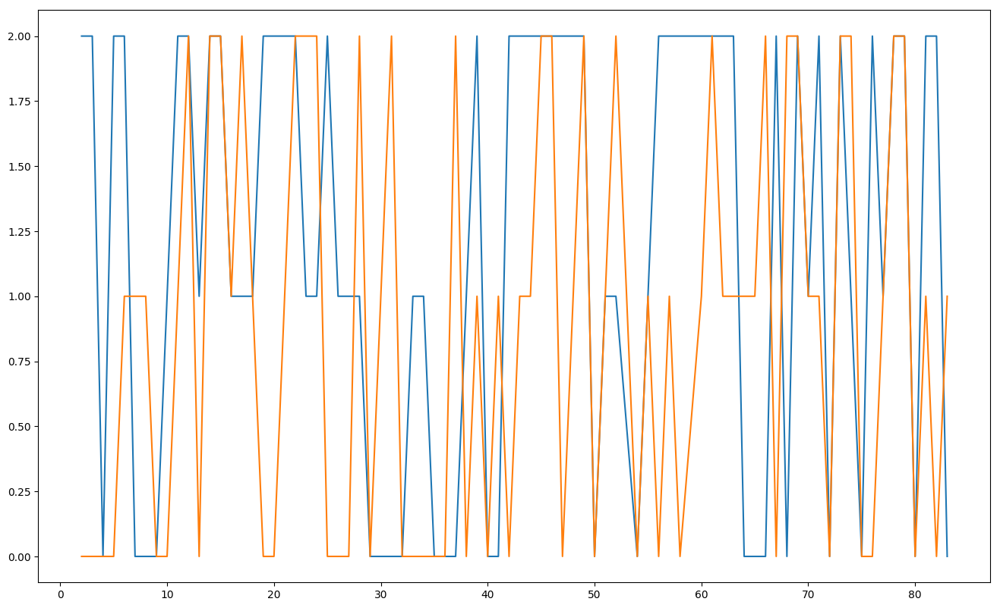

In [75]:
plt.plot(data_combined["index"], data_combined["inState_x"])
plt.plot(data_combined["index"], data_combined["inState_y"])

In [ ]:
pre = "/Users/weilu/Research/server/mar_2020/mass_iterative_run/iteration_0_stronger_exclude_volume/1a32/0"
pdbFile = f"{pre}/lastFrame.pdb"
parser = PDBParser()
structure = parser.get_structure("X", pdbFile)
seq = read_fasta(f"{pre}/crystal_structure.fasta")
info_ = []
for res in structure.get_residues():
    if res.get_full_id()[1] != 0:
        continue
    # x_com = get_side_chain_center_of_mass(res)
    # resname = res.resname
    resname = one_to_three(seq[res.id[1]-1])
    if resname == "GLY":
        continue
    try:
        n = res["N"].get_coord()
        ca = res["CA"].get_coord()
        c = res["C"].get_coord()
    except:
        print("normal? ", res)
        continue
    x_com = res["CB"].get_coord()
    x = np.array([dis(x_com, n), dis(x_com, ca), dis(x_com, c)])
    r_ca_com = dis(x_com, ca)
#     resname = "TYR"
    if resname == "GLY":
        prediction = [0, 0, 0]
    else:
        prediction = gmm_dic[resname].predict_proba(np.array(x).reshape(1, -1))[0].round(3)
    info_.append([res.id[1], resname, np.argmax(prediction), prediction[0], prediction[1], prediction[2]])